# Exercise 1
Given that working with R is limited to the old version of the EDC, here I'll try to work from `Julia`. This notebook will address the following ideas / experiments:

1. Calculate EWS in time
2. Calculate fractal dimensions
3. Use CCM combining space and time

In [1]:
# using Pkg; Pkg.add("NamedArrays")
# using NamedArrays

using Pkg
Pkg.add("ESDL")
Pkg.add("RCall")
Pkg.add("ESDLPlots")

  Updating registry at `/opt/julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
 Resolving package versions...
  Updating `/opt/julia/environments/v1.1/Project.toml`
 [no changes]
  Updating `/opt/julia/environments/v1.1/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `/opt/julia/environments/v1.1/Project.toml`
 [no changes]
  Updating `/opt/julia/environments/v1.1/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `/opt/julia/environments/v1.1/Project.toml`
 [no changes]
  Updating `/opt/julia/environments/v1.1/Manifest.toml`
 [no changes]


In [2]:
using ESDL
using ESDLPlots
using RCall

HTML{String}("    <script id=\"webio-setup-13298208455519584408\">\n    // Immediately-invoked-function-expression to avoid global variables.\n    (function() {\n        var warning_div = document.getElementById(\"webio-warning-11299541568169841076\");\n        var hide = function () {\n            var script = document.getElementById(\"webio-setup-13298208455519584408\");\n            var parent = script && script.parentElement;\n            var grandparent = parent && parent.parentElement;\n            if (grandparent) {\n                grandparent.style.display = \"none\";\n            }\n            warning_div.style.display = \"none\";\n        };\n        if (typeof Jupyter !== \"undefined\") {\n            console.log(\"WebIO detected Jupyter notebook environment.\");\n            // Jupyter notebook.\n            var extensions = (\n                Jupyter\n                && Jupyter.notebook.config.data\n                && Jupyter.notebook.config.data.load_extensions\n            );\n            if (extensions && extensions[\"webio/main\"]) {\n                // Extension already loaded.\n                console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n                hide();\n                return;\n            }\n            console.warn(\"Loading WebIO Jupyter extension on an ad-hoc basis. Consider enabling the WebIO nbextension for a stabler experience (this should happen automatically when building WebIO).\");\n            require([\"/user/juanrocha//assetserver/e3554fa679cf5c34f21c638422ec9188e5d571d2-dist/main.js\"], function (webIOModule) {\n                webIOModule.load_ipython_extension();\n            });\n            warning_div.innerHTML = \"<strong>Loading WebIO Jupyter extension on an ad-hoc basis. Consider enabling the WebIO nbextension for a stabler experience (this should happen automatically when building WebIO).</strong>\";\n        } else if (window.location.pathname.includes(\"/lab\")) {\n            // Guessing JupyterLab\n            warning_div.innerHTML = \"WebIO does not support JupyterLab yet.\";\n        }\n    })();\n    </script>\n    <div\n        id=\"webio-warning-11299541568169841076\"\n        class=\"output_text output_stderr\"\n        style=\"padding: 1em; font-weight: bold;\"\n    >\n        Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n        <!-- TODO: link to installation docs. -->\n    </div>\n")

┌ Info: Precompiling RCall [6f49c342-dc21-5d91-9882-a32aef131414]
└ @ Base loading.jl:1186


 Resolving package versions...
  Updating `/opt/julia/environments/v1.1/Project.toml`
 [no changes]
  Updating `/opt/julia/environments/v1.1/Manifest.toml`
 [no changes]


In [5]:
c = Cube()

Collection of ZArray Cube with the following dimensions
Lon                 Axis with 1440 Elements from -179.875 to 179.875
Lat                 Axis with 720 Elements from 89.875 to -89.875
Time                Axis with 1702 Elements from 1980-01-05 to 2016-12-30
Variable            Axis with 75 elements: evaporative_stress free_msr_lrt .. lrt_c burnt_area 
Total size: 616.29 GB


In [6]:
ndims(c)

4

In [7]:
import Statistics: var, mean

In [20]:
d = subsetcube(c, variable = ["gross_primary_productivity"], time = 2001:2011)
# cube_filled = gapFillMSC(d);
# d2 = filterTSFFT(cube_filled)

In [22]:
x = subsetcube(d, time = (2001:2005))

ZArray Cube with the following dimensions
Lon                 Axis with 1440 Elements from -179.875 to 179.875
Lat                 Axis with 720 Elements from 89.875 to -89.875
Time                Axis with 229 Elements from 2001-01-05 to 2005-12-23
Total size: 1.11 GB


In [23]:
y = mapslices(var ∘ skipmissing, x, dims = "Time")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:10


In-Memory data cube with the following dimensions
Lon                 Axis with 1440 Elements from -179.875 to 179.875
Lat                 Axis with 720 Elements from 89.875 to -89.875
Total size: 4.94 MB


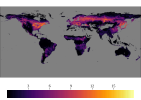

In [24]:
display(plotMAP(y))

In [25]:
z= y[:,:] # this is an array, finally!
R"sum(is.na($z))"

RObject{IntSxp}
[1] 826029


In [39]:
# using Rcall
# R"library(rEDM); library(earlywarnings)"
typeof(z)

Array{Union{Missing, Float32},2}

Progress: 100%|█████████████████████████████████████████| Time: 0:00:10


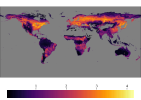

In [27]:
import Statistics: var, mean, std
v1 = mapslices(std ∘ skipmissing, x, dims = "Time")
display(plotMAP(v1))


In [71]:
R"xout <- list()"

yr_0 = 2000
yr = 2005

for i in 1:5 
    out = mapslices(         
        std ∘ skipmissing, 
        subsetcube(d, time = (yr_0+i:yr+i)),
        dims = "Time")
    z = out[:,:]
    R"xout[[$i]] <- $z"
end



Progress: 100%|█████████████████████████████████████████| Time: 0:00:10
Progress: 100%|█████████████████████████████████████████| Time: 0:00:10
Progress: 100%|█████████████████████████████████████████| Time: 0:00:11
Progress: 100%|█████████████████████████████████████████| Time: 0:00:10
Progress: 100%|█████████████████████████████████████████| Time: 0:00:10


In [72]:
R"dim(xout[[1]])"

lon = getAxis("lon", d).values
lat = getAxis("lat", d).values

lat

89.875f0:-0.25f0:-89.875f0

In [73]:
R"dim(xout[[1]])"

RObject{IntSxp}
[1] 1440  720


In [35]:
R"library(tidyverse)"

┌ Warning: RCall.jl: ── Attaching packages ─────────────────────────────────────── tidyverse 1.2.1 ──
│ ✔ ggplot2 3.2.0     ✔ purrr   0.3.2
│ ✔ tibble  2.1.1     ✔ dplyr   0.8.1
│ ✔ tidyr   0.8.3     ✔ stringr 1.4.0
│ ✔ readr   1.3.1     ✔ forcats 0.4.0
│ ── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
│ ✖ dplyr::filter() masks stats::filter()
│ ✖ dplyr::lag()    masks stats::lag()
└ @ RCall /opt/julia/packages/RCall/iojZI/src/io.jl:113


RObject{StrSxp}
 [1] "forcats"   "stringr"   "dplyr"     "purrr"     "readr"     "tidyr"    
 [7] "tibble"    "ggplot2"   "tidyverse" "stats"     "graphics"  "grDevices"
[13] "utils"     "datasets"  "methods"   "base"     


In [74]:
R"object.size(xout)

lon <- $lon
lat <- $lat

xout <- map(
    xout,
    function(x){
        rownames(x) <- lon
        colnames(x) <- lat
        return(x)
}
)
";

In [75]:
R"

xout <- map(
  xout, function(x){
    x %>%
    as_tibble(rownames = 'lon') %>%
    mutate(lat = as.numeric(lon)) %>%
    gather(key = 'lat', value = 'gpp', 2:722, na.rm = FALSE)
    }
)
";

In [88]:
R"
for (i in 1:5){
  xout[[i]] <- xout[[i]] %>% add_column(window = i)
}
"

RObject{NilSxp}
NULL


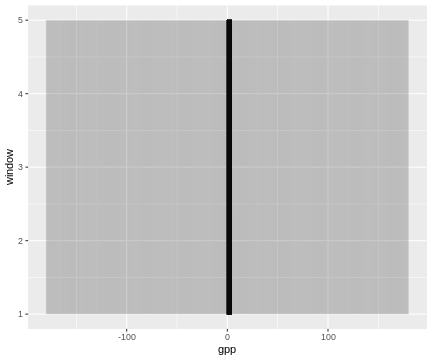

RObject{VecSxp}


In [106]:
#R"
# dat <- bind_rows(xout)
# dat %>% 
#   filter(!is.na(gpp)) %>%
#   group_by(lon, lat) %>%
#   unite(lon,lat, col = id, sep= '_', remove = FALSE) %>%
#   ggplot(aes(gpp, window)) + geom_line(aes(group = id), alpha = 0.05)
# "

In [109]:
R"
sart <- Sys.time()
models <- dat %>% 
  filter(!is.na(gpp)) %>%
  unite(lon,lat, col = id, sep= '_', remove = FALSE) %>%
  split(.$id) %>%
  map(~lm(gpp ~ window, data = .))
end <- Sys.time()

end - start
";

RObject{VecSxp}
$`-0.125_10.125`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
   1.666571     0.003175  


$`-0.125_10.375`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
    1.47242     -0.00195  


$`-0.125_10.625`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
   1.380540     0.002278  


$`-0.125_10.875`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
    1.03068      0.01013  


$`-0.125_11.125`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
   1.064468    -0.002705  


$`-0.125_11.375`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
    1.34091     -0.01156  


$`-0.125_11.625`

Call:
lm(formula = gpp ~ window, data = .)

Coefficients:
(Intercept)       window  
    1.23161     -0.01292  


$`-0.125_11.875`

Call:
lm(formula = gpp ~ window, data = .)

In [145]:
R"""
slope = map_dbl(models, function(x){coef(x)[2]})
names(slope) <- NULL
head(slope)
""";


In [152]:
R"
dat 

"

RObject{VecSxp}
# A tibble: 5,191,200 x 4
   lon      lat      gpp window
   <chr>    <chr>  <dbl>  <int>
 1 -179.875 89.875    NA      1
 2 -179.625 89.875    NA      1
 3 -179.375 89.875    NA      1
 4 -179.125 89.875    NA      1
 5 -178.875 89.875    NA      1
 6 -178.625 89.875    NA      1
 7 -178.375 89.875    NA      1
 8 -178.125 89.875    NA      1
 9 -177.875 89.875    NA      1
10 -177.625 89.875    NA      1
# … with 5,191,190 more rows


In [63]:
getAxis("Variable", c).values

75-element Array{String,1}:
 "evaporative_stress"           
 "free_msr_lrt"                 
 "latent_energy"                
 "fat_p"                        
 "black_sky_albedo_avhrr"       
 "fapar_tip"                    
 "totcol_msr"                   
 "lrt_p"                        
 "aerosol_optical_thickness_870"
 "totcol_assim"                 
 "root_moisture"                
 "srex_mask"                    
 "snow_water_equivalent"        
 ⋮                              
 "cfc"                          
 "black_sky_albedo"             
 "cot"                          
 "ctt"                          
 "lwp"                          
 "chlor_a"                      
 "aerosol_optical_thickness_670"
 "interception_loss"            
 "stemp"                        
 "Rg"                           
 "lrt_c"                        
 "burnt_area"                   